In [15]:
#!/usr/bin/env python3
# -*- coding: utf-8 -*-
"""
Created on Tue Jun  7 12:02:15 2022

@author: sunms498
"""

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import xarray as xr
from os import walk
import pickle
from pathlib import Path
from shapely.geometry import Point
import geopandas as gpd
from geopandas import GeoDataFrame
from matplotlib.colors import LogNorm
from scipy.stats import norm
from scipy.stats import entropy
import cmcrameri.cm as cmc
import cmocean as cmo
import sys
from pathlib import Path
from matplotlib.colors import LogNorm
import pandas as pd
module_path = Path().resolve().parents[1] / "src" / "postprocessing"

# Append the directory to sys.path
sys.path.append(str(module_path))


#from CurveFitting import * #Very expensive on the CPU!!
from visualizePredictionMap import *

In [16]:
#load porosity file

file_porosity = Path().resolve().parents[1] / "data" / "interim" / "porosity" / "grl53425-sup-0002-supinfo.grd"
#file_porosity = "file_porosity = "/home/sunms498/Data/paper_porosity/GPSM_Restreppo/prediction.nc""
rootgrp_porosity = xr.open_dataset(Path(file_porosity), format = 'NETCDF4')
                                                                   
dataset_porosity = rootgrp_porosity.variables['z']

dataset_numpy_porosity = dataset_porosity.to_numpy()
dataset_numpy_porosity = np.rot90(np.rot90(np.fliplr(dataset_numpy_porosity)))

ds=2.6 #bulk density of marine soil

In [17]:
# make area of the cells file, based on the latitude


restrepo_features_path = Path().resolve().parents[1] / "data" / "raw" / "features" / "FeaturesPhrampusLee_TOCSedRate_updated" / "GL_LATITUDE_DD.5m.nc"
restrepo_files = []

for (dirpath, dirnames, filenames) in walk(restrepo_features_path):
    restrepo_files.extend(filenames)

restrepo_files.sort()
len(restrepo_files)

rootgrp = xr.open_dataset(restrepo_features_path, format = 'NETCDF4')
latitudes = rootgrp.variables['lat']
longitudes = rootgrp.variables['lon']


file_idx = -1
corrupted_files = 0

rootgrp = xr.open_dataset(restrepo_features_path, format = 'NETCDF4')

dataset = rootgrp.variables['data']
area = 9.297**2 * np.cos(dataset/180 * np.pi) # in km2

In [18]:
filename = Path().resolve().parents[1] / "data" / "output" / "predictionmaps_TOC" / "prediction_map_dist_CS_v2.npy"
prediction_dist_CS = np.load(filename)
prediction_dist_DO = np.load(Path().resolve().parents[1] / "data" / "output" / "predictionmaps_TOC" / "prediction_map_dist_DO_v2.npy")

dataset_mask = np.load(Path().resolve().parents[1] / "data" / "interim" / "masks" / "mask_deepocean.npy")
dataset_mask = np.rot90(np.rot90(np.fliplr(dataset_mask)))
land_file = Path().resolve().parents[2] / "nn4sedratetoc" / "data" / "raw" / "island_map.npy"
land_map = np.load(land_file)
land_map[np.isnan(land_map)] = 1



# Flip along the last axis (axis=2)
prediction_dist_DO = np.flip(prediction_dist_DO, axis=2)
prediction_dist_CS = np.flip(prediction_dist_CS, axis=2)

# If you also want to rotate the flipped array, you can use np.rot90
prediction_dist_DO = np.rot90(prediction_dist_DO, k=2, axes=(1, 2))
prediction_dist_CS = np.rot90(prediction_dist_CS, k=2, axes=(1, 2))



prediction_dist_overlapped = np.copy(prediction_dist_DO)

for i in range(prediction_dist_CS.shape[0]):
    # Mask the values from pm_CS where mask contains NaN values
    prediction_dist_overlapped[i, :, :][np.isnan(dataset_mask)] = prediction_dist_CS[i, :, :][np.isnan(dataset_mask)]
    if i%10 ==0:
        print(i)
for i in range(prediction_dist_overlapped.shape[0]):
    prediction_dist_overlapped[i, :, :][land_map] = np.nan


0
10
20
30
40
50
60
70
80
90


In [19]:
prediction_dist_overlapped_original = prediction_dist_overlapped.mean(axis = 0)

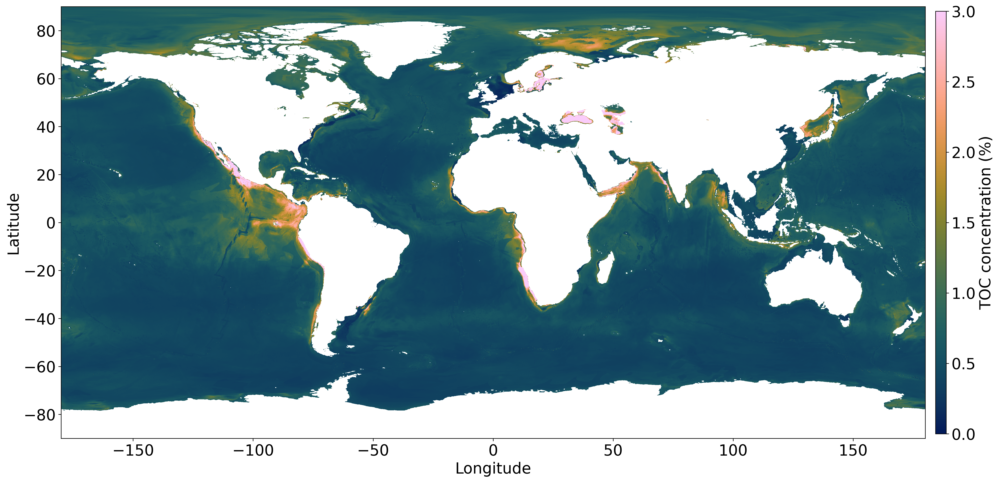

In [20]:
VisualiseMap(prediction_dist_overlapped_original, cmap=cmc.batlow, use_log_norm=False, vmin=0, vmax=3, cbar_label= "TOC concentration (%)")#cmc.tokyo#"cubehelix"

In [21]:
prediction_dist_overlapped_std_original = prediction_dist_overlapped.std(axis = 0)

In [22]:
np.nanmean(prediction_dist_overlapped_original)

0.6210535407568498

In [23]:
param_opt_list = np.load("preprocessed/param_opt_list_v2.npy")
cov_matrix_list = np.load("preprocessed/cov_matrix_list.npy")

In [24]:
"""
# Calculate PDFs for original data set
pdf_original_std = norm.pdf(prediction_dist_overlapped, param_opt_list[1], param_opt_list[2])
# Initialize an array to store new distributions
new_dist = np.empty([100, prediction_dist_overlapped.shape[1], prediction_dist_overlapped.shape[2]])

# Generate random normal distributions and calculate PDFs
for i in range(2160):
    for j in range(4320):
        new_dist[:,i, j] = np.random.normal(prediction_dist_overlapped.mean(axis = 0)[i, j], 0.1, 100)
"""    

'\n# Calculate PDFs for original data set\npdf_original_std = norm.pdf(prediction_dist_overlapped, param_opt_list[1], param_opt_list[2])\n# Initialize an array to store new distributions\nnew_dist = np.empty([100, prediction_dist_overlapped.shape[1], prediction_dist_overlapped.shape[2]])\n\n# Generate random normal distributions and calculate PDFs\nfor i in range(2160):\n    for j in range(4320):\n        new_dist[:,i, j] = np.random.normal(prediction_dist_overlapped.mean(axis = 0)[i, j], 0.1, 100)\n'

In [25]:
# Calculate PDFs for original data set
pdf_original_std = norm.pdf(prediction_dist_overlapped, param_opt_list[1], param_opt_list[2])

# Step 1: Calculate the mean along axis 0
mean_prediction = prediction_dist_overlapped.mean(axis=0)  # Shape will be (2160, 4320)

# Step 2: Generate the new distribution using broadcasting
new_dist = np.random.normal(mean_prediction, 0.1, (100, 2160, 4320))
# Calculate PDFs for the new data set
pdf_new_std = norm.pdf(new_dist, param_opt_list[1], 0.1)

# Calculate KL divergence using vectorized operations
kl_divergence_original = entropy(pdf_new_std, pdf_original_std, axis=0)

In [26]:
#kl_divergence_original = kl_divergence.copy()

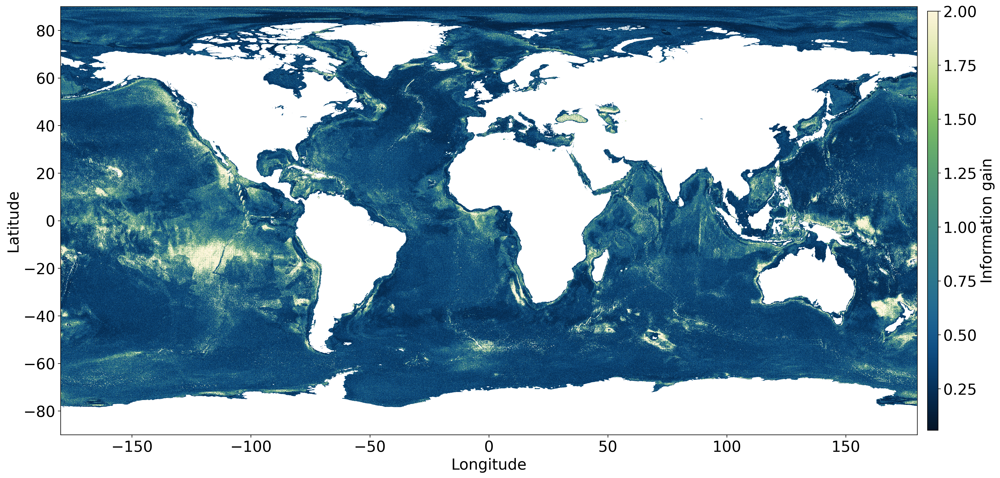

In [27]:
#kl_divergence = np.load("kl_divergence.npy")
kl_divergence_original[:, :][land_map] = np.nan
VisualiseMap(kl_divergence_original, cmap=cmc.navia, vmax=2, cbar_label= "Information gain")